<a href="https://colab.research.google.com/github/seongcho1/multilayer-perceptron-data/blob/master/42_multilayer_perceptron(colab).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

---
* 최초 작성일 : 2022.12.27
* 최종 수정일 : 2022.12.27
---

#**1.개요 및 데이터 불러오기**

##**1-1.개요**

 * 로지스틱 회귀를 이용한 분류?

    * 독립 변수(X)와 종속 변수 (Y)의 관계를 구해내는 선형 회귀 분석과 유사하나, 종속 변수가 범주로 구성된 데이터를 대상으로 한다는 차이가 있다.

 * 실습목표
   * predict whether a cancer is malignant or benign on a dataset of
breast cancer diagnosis in the Wisconsin.
   * 종양은 일반적으로 임상 경과에 따라 크게 ‘양성종양(benign tumor)’과 ‘악성종양(malignant tumor)’으로 구분한다. 양성종양은 한정된 범위 내에서 성장하다가 중단되고, 피막에 싸여 침윤과 전이가 없어 예후가 좋지만, 악성종양은 그 반대로 암(cancer)이라 불린다. ‘cancer’라는 단어 자체는 라틴어에서 유래한 것으로 ‘게(crab)’를 뜻하고, 혈관이 발달한 종양의 모습이 마치 ‘게 등딱지’처럼 침습하는 것처럼 보여 붙여진 이름이다.

   * 탐색적 데이터 분석 및 시각화를 통하여 데이터의 특성을 파악한다. 
   * 머신러닝 알고리즘 중 경사하강법을 사용한다.
   * 종속 변수 Y의 범주 : Categories (2): ['M', 'B']

   * 보너스: 최적화 알고리즘 (모멘텀, 아다그라드, RMSProp, 아담 등)
   * 보너스: 하나의 그래프에 다양한 러닝 커브를 표현 (다른 모델 비교)
   * 보너스: early stopping 구현
   * 보너스: dropout


 * 실습내용
   * 분석 데이터 로드, 탐색적 데이터 분석(EDA), 시각화를 통한 데이터 특성 파악.
   * 데이터 분리(train, test)    
   * 양성 종양 (B)과 악성 종양(M) 분류 모델 구성 및 학습.

 * 실습 데이터

   * 의료 데이터셋 (a dataset of
breast cancer diagnosis in the Wisconsin) 
   * 의미있는 정보가 있는 컬럼을 어떻게 선택하는지 생각해 보자.
   * 라벨데이터는 두번째 컬럼으로 부터 얻을 수 있다.  

* 데이터 구성

  * 데이터는 data.csv파일에서 얻을 수 있으며 32개의 columns과 569개의 rows로 구성 되어 있다. 





In [5]:
#data clone
#!git clone https://github.com/seongcho1/multilayer-perceptron
!git clone https://github.com/seongcho1/multilayer-perceptron-data

fatal: destination path 'multilayer-perceptron-data' already exists and is not an empty directory.


In [6]:
#자주 사용하는 라이브러리 임포트 
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

#소숫점 자리수 표시 방법 지정 
pd.options.display.float_format = '{:.5f}'.format

#경고메세지 제거 
import warnings
warnings.filterwarnings('ignore')

## 1-2. 데이터 불러오기

In [7]:
# 데이터 불러오기
location = "./multilayer-perceptron-data/datasets/data.csv"

df = pd.read_csv(location, header=None)
df.head()

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
0,842302,M,17.99000,10.38000,122.80000,1001.00000,0.11840,0.27760,0.30010,0.14710,...,25.38000,17.33000,184.60000,2019.00000,0.16220,0.66560,0.71190,0.26540,0.46010,0.11890
1,842517,M,20.57000,17.77000,132.90000,1326.00000,0.08474,0.07864,0.08690,0.07017,...,24.99000,23.41000,158.80000,1956.00000,0.12380,0.18660,0.24160,0.18600,0.27500,0.08902
2,84300903,M,19.69000,21.25000,130.00000,1203.00000,0.10960,0.15990,0.19740,0.12790,...,23.57000,25.53000,152.50000,1709.00000,0.14440,0.42450,0.45040,0.24300,0.36130,0.08758
3,84348301,M,11.42000,20.38000,77.58000,386.10000,0.14250,0.28390,0.24140,0.10520,...,14.91000,26.50000,98.87000,567.70000,0.20980,0.86630,0.68690,0.25750,0.66380,0.17300
4,84358402,M,20.29000,14.34000,135.10000,1297.00000,0.10030,0.13280,0.19800,0.10430,...,22.54000,16.67000,152.20000,1575.00000,0.13740,0.20500,0.40000,0.16250,0.23640,0.07678


##1-3.데이터 확인




* 데이터셋 정보 확인

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       569 non-null    int64  
 1   1       569 non-null    object 
 2   2       569 non-null    float64
 3   3       569 non-null    float64
 4   4       569 non-null    float64
 5   5       569 non-null    float64
 6   6       569 non-null    float64
 7   7       569 non-null    float64
 8   8       569 non-null    float64
 9   9       569 non-null    float64
 10  10      569 non-null    float64
 11  11      569 non-null    float64
 12  12      569 non-null    float64
 13  13      569 non-null    float64
 14  14      569 non-null    float64
 15  15      569 non-null    float64
 16  16      569 non-null    float64
 17  17      569 non-null    float64
 18  18      569 non-null    float64
 19  19      569 non-null    float64
 20  20      569 non-null    float64
 21  21      569 non-null    float64
 22  22

* 데이터 형태 및 요약정보 확인

In [9]:
#데이터 행과 열
print(df.shape)

#데이터 요약 정보 
df.describe(include='all').T

(569, 32)


,count,unique,top,freq,mean,std,min,25%,50%,75%,max
0,569.00000,NaN,NaN,NaN,30371831.43234,125020585.61222,8670.00000,869218.00000,906024.00000,8813129.00000,911320502.00000
1,569,2,B,357,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,569.00000,NaN,NaN,NaN,14.12729,3.52405,6.98100,11.70000,13.37000,15.78000,28.11000
3,569.00000,NaN,NaN,NaN,19.28965,4.30104,9.71000,16.17000,18.84000,21.80000,39.28000
4,569.00000,NaN,NaN,NaN,91.96903,24.29898,43.79000,75.17000,86.24000,104.10000,188.50000
5,569.00000,NaN,NaN,NaN,654.88910,351.91413,143.50000,420.30000,551.10000,782.70000,2501.00000
6,569.00000,NaN,NaN,NaN,0.09636,0.01406,0.05263,0.08637,0.09587,0.10530,0.16340
7,569.00000,NaN,NaN,NaN,0.10434,0.05281,0.01938,0.06492,0.09263,0.13040,0.34540
8,569.00000,NaN,NaN,NaN,0.08880,0.07972,0.00000,0.02956,0.06154,0.13070,0.42680
9,569.00000,NaN,NaN,NaN,0.04892,0.03880,0.00000,0.02031,0.03350,0.07400,0.20120


* 데이터 null값 확인

In [10]:
#데이터 null값 확인(합계) 
df.isnull().sum()

0     0
1     0
2     0
3     0
4     0
5     0
6     0
7     0
8     0
9     0
10    0
11    0
12    0
13    0
14    0
15    0
16    0
17    0
18    0
19    0
20    0
21    0
22    0
23    0
24    0
25    0
26    0
27    0
28    0
29    0
30    0
31    0
dtype: int64

# **2. 데이터 탐색** <br>

---
데이터 탐색 파트는 아래 순서로 진행됨<br>
2-1. 분포 확인<br>
2-2. 종속변수 생성<br>

---

## 2-1. 분포확인

* 시각화 및 분석을 위한 컬럼명 변수저장

In [11]:
# 시각화를 위한 컬럼명 변수저장
# 독립변수 데이터컬럼 리스트 초기화
data_cols = []

# 독립변수 데이터컬럼 길이 초기화
len_of_data_cols = 0

for col in df.columns:
    if( col != 1):
      data_cols.append(col)
      len_of_data_cols += 1
print('data_cols : ',data_cols)
print(len_of_data_cols)

# 종속변수 레이블컬럼 리스트
label = 1
print('label : ',label)

data_cols :  [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31]
31
label :  1


* 데이터 의 분포

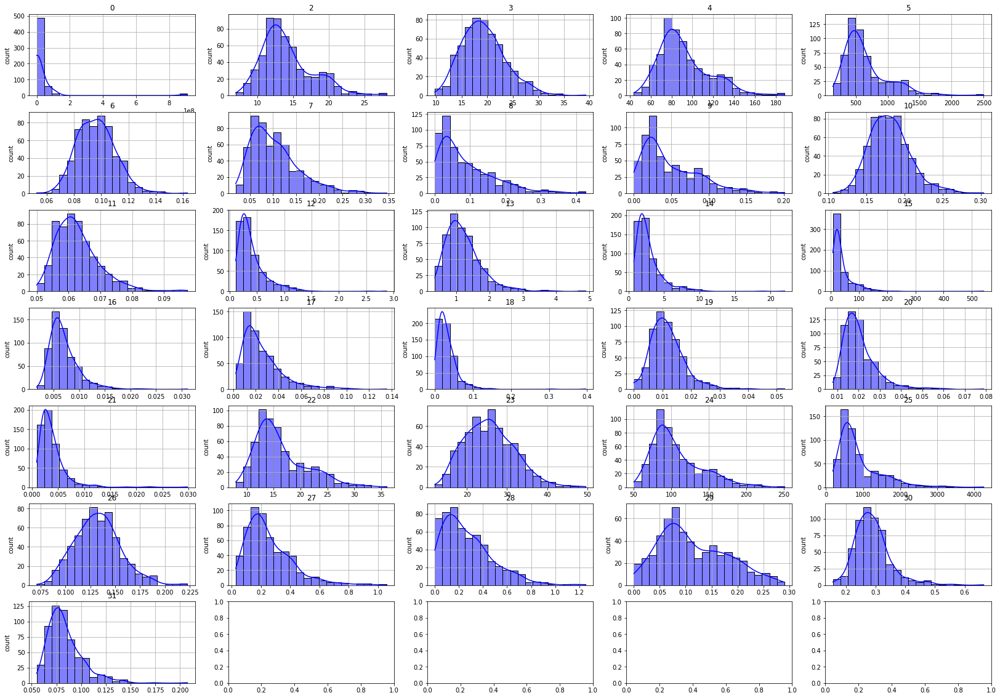

In [12]:
#숫자 컬럼 31개
f, axes = plt.subplots(7, 5, figsize=(28, 20))
col_no = 0
for x in range(0,7):
    for y in range(0,5):
        if (col_no < len_of_data_cols):
          ax = sns.histplot(df[data_cols[col_no]], bins=20,  color="blue", alpha=0.5, kde=True, ax=axes[x, y])
          ax.grid(b=True)
          ax.set(xlabel="",ylabel="count" ,title=data_cols[col_no])
          col_no +=1
        

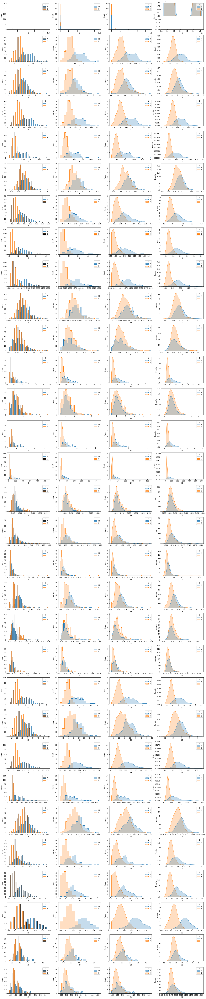

In [13]:
#각 컬럼 별 히스토그램
#Which column has a homogeneous distribution between M and B?

y = 1
f, axes = plt.subplots(len_of_data_cols, 4, figsize=(24, 4 * len_of_data_cols))

for i in range(0, len_of_data_cols):

  ax = sns.histplot(data=df, x=data_cols[i], hue=label, multiple="dodge", shrink=.8, ax=axes[i, 0])
  ax = sns.histplot(data=df, x=data_cols[i], hue=label, element="step", ax=axes[i, 1])
  ax = sns.histplot(data=df, x=data_cols[i], hue=label, element="poly", ax=axes[i, 2])
  ax = sns.kdeplot(data=df, x=data_cols[i], hue=label, fill='true', ax=axes[i, 3])



[0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31] <class 'list'>
[0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31]


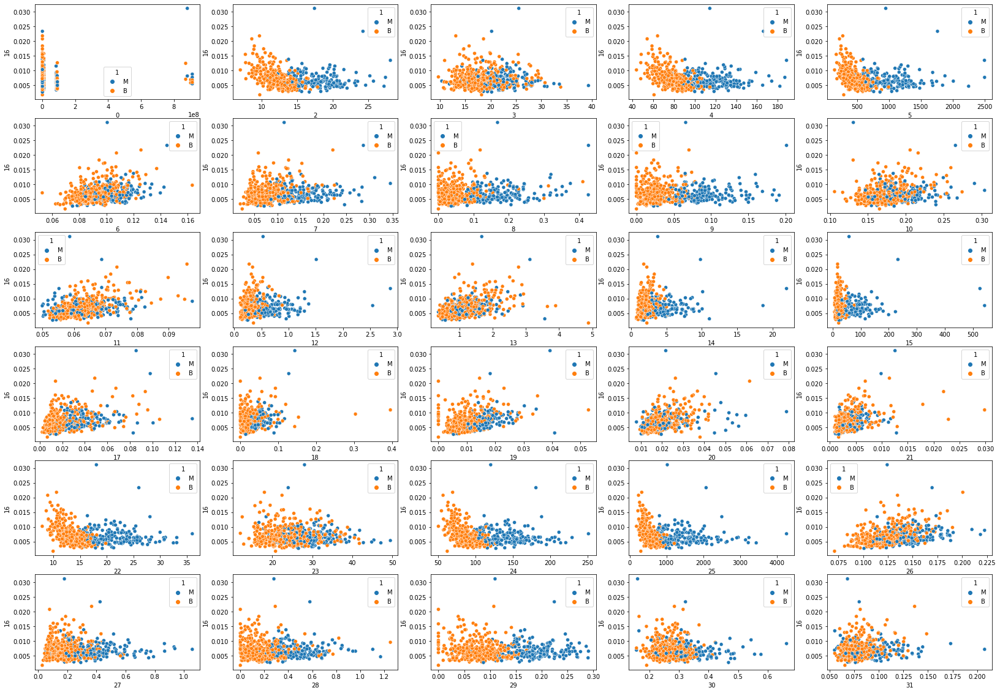

In [14]:
#특정 두 컬럼의 스캐터  플롯
#What are the two features that are similar ?

import copy

f, axes = plt.subplots(6, 5, figsize=(28, 20))
print(data_cols, type(data_cols))
scatter_cols = copy.deepcopy(data_cols)

#의미없는 컬럼들
#0

i = 16 #[0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31]
idx = scatter_cols.index(i)
del scatter_cols[idx]
print(scatter_cols)

col_no = 0
for x in range(0,6):
    for y in range(0,5):
        ax = sns.scatterplot(data=df, x=scatter_cols[col_no], y=i, hue=label, ax=axes[x,y])
        col_no +=1

* 레이블의 분포

,B,M
1,357,212


([<matplotlib.patches.Wedge at 0x7fa6414f1be0>,
 [Text(-0.4286546999573329, 1.0130425204326268, 'M'),
  Text(0.428654605109445, -1.013042560566172, 'B')],
 [Text(-0.23381165452218156, 0.5525686475087055, '63%'),
  Text(0.23381160278696997, -0.55256866939973, '37%')])

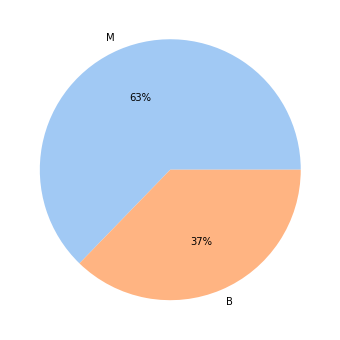

In [16]:
labels = df[label].unique()
value_df = pd.DataFrame(df[label].value_counts())
display(value_df.T)

plt.figure(figsize = (6, 6))
colors = sns.color_palette('pastel')[0:2]
#create pie chart
plt.pie(value_df.T, labels = labels, colors = colors, autopct='%.0f%%')

* 각 필드별 boxplot  

[2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31]


[Text(0, 0.5, 'valus'), Text(0.5, 0, 'data'), Text(0.5, 1.0, 'data_fields')]

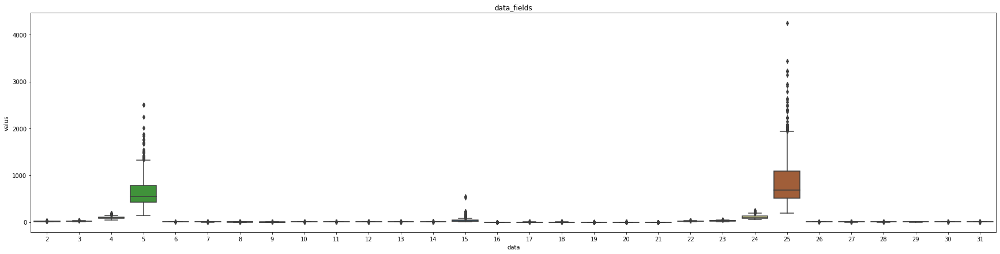

In [ ]:
import scipy
from scipy import stats

#의미없는 0번째 컬럼 삭제 
data_cols2 = copy.deepcopy(data_cols)
idx = data_cols2.index(0)
del data_cols2[idx]
print(data_cols2)

plt.figure(figsize = (30, 7))

ax = sns.boxplot(data=df[data_cols2], palette = 'Paired')
ax.set(xlabel="data", ylabel="valus",title='data_fields')
#plt.xticks(rotation=45)

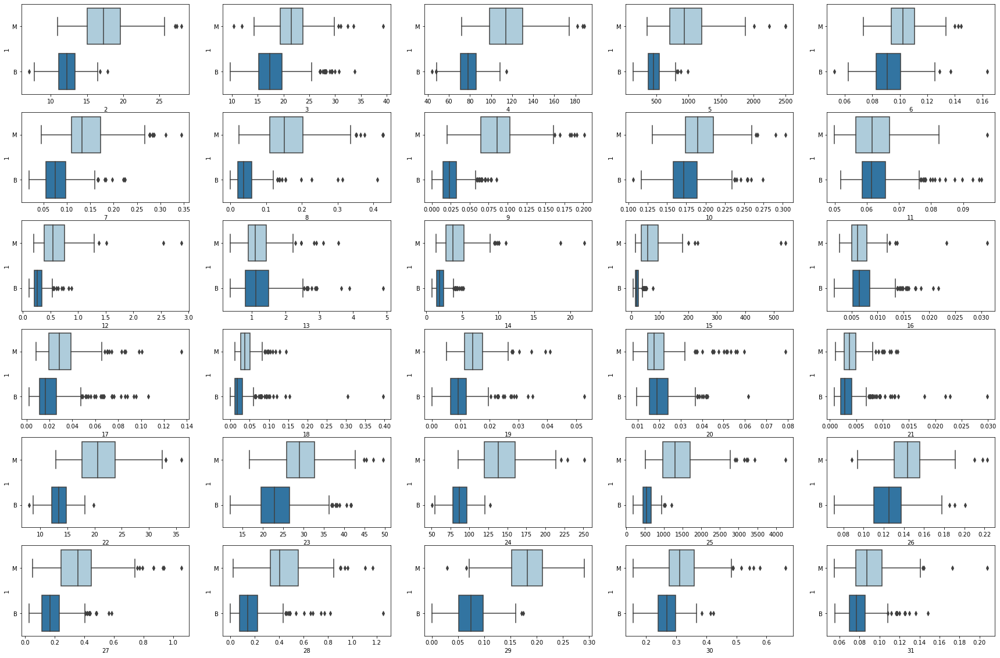

In [ ]:

f, axes = plt.subplots(6, 5, figsize=(30, 20))

col_no = 0
for x in range(0,6):
    for y in range(0,5):
        #if (col_no < scatter_cols):
          ax = sns.boxplot(data=df, x= data_cols2[col_no], y=label, palette = 'Paired', ax=axes[x,y])
          col_no +=1


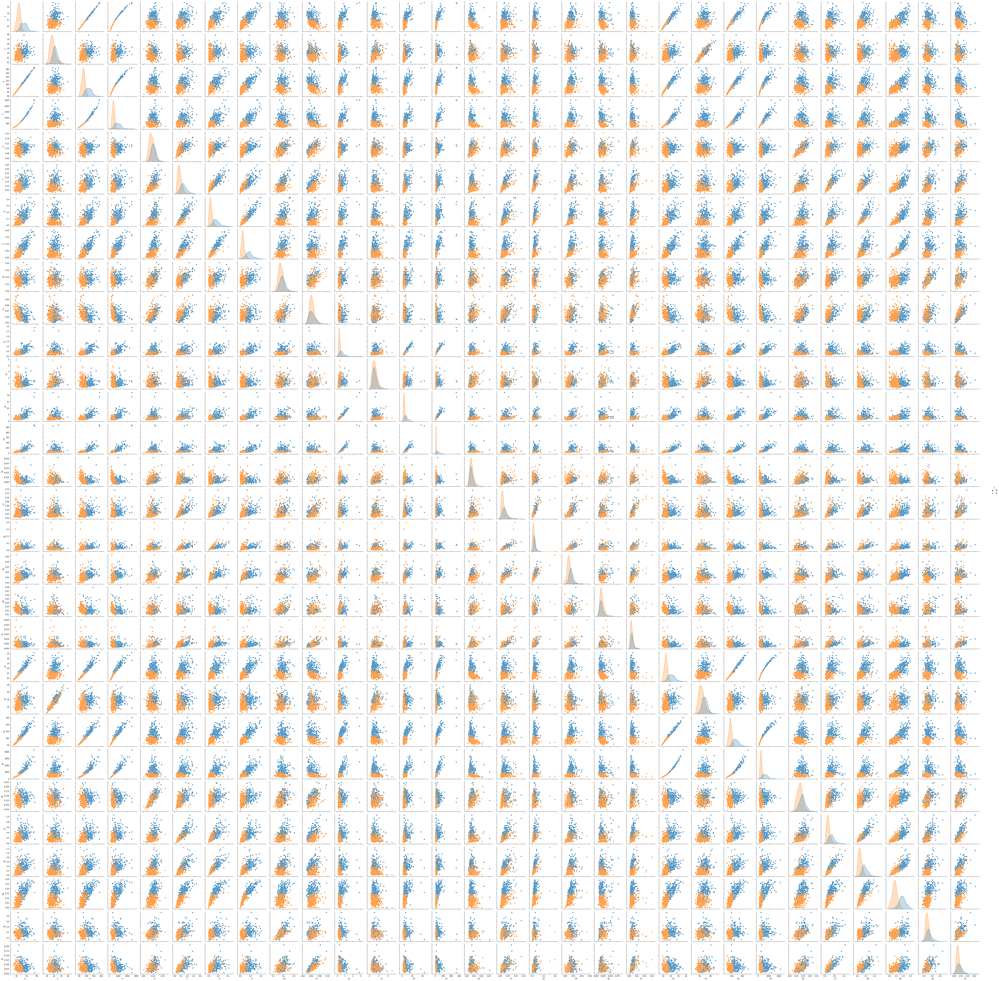

In [ ]:
#From this visualization, what features are you going to use for your logistic regression?
#pair plot

# Drop first column of dataframe, drop 'id' column
df4pair = df.iloc[: , 1:] 

sns.pairplot(df4pair, hue=label)

[2, 3, 6, 7, 8, 9, 10, 12, 14, 15, 17, 18, 19, 22, 23, 26, 27, 28, 29, 30, 31, 1]


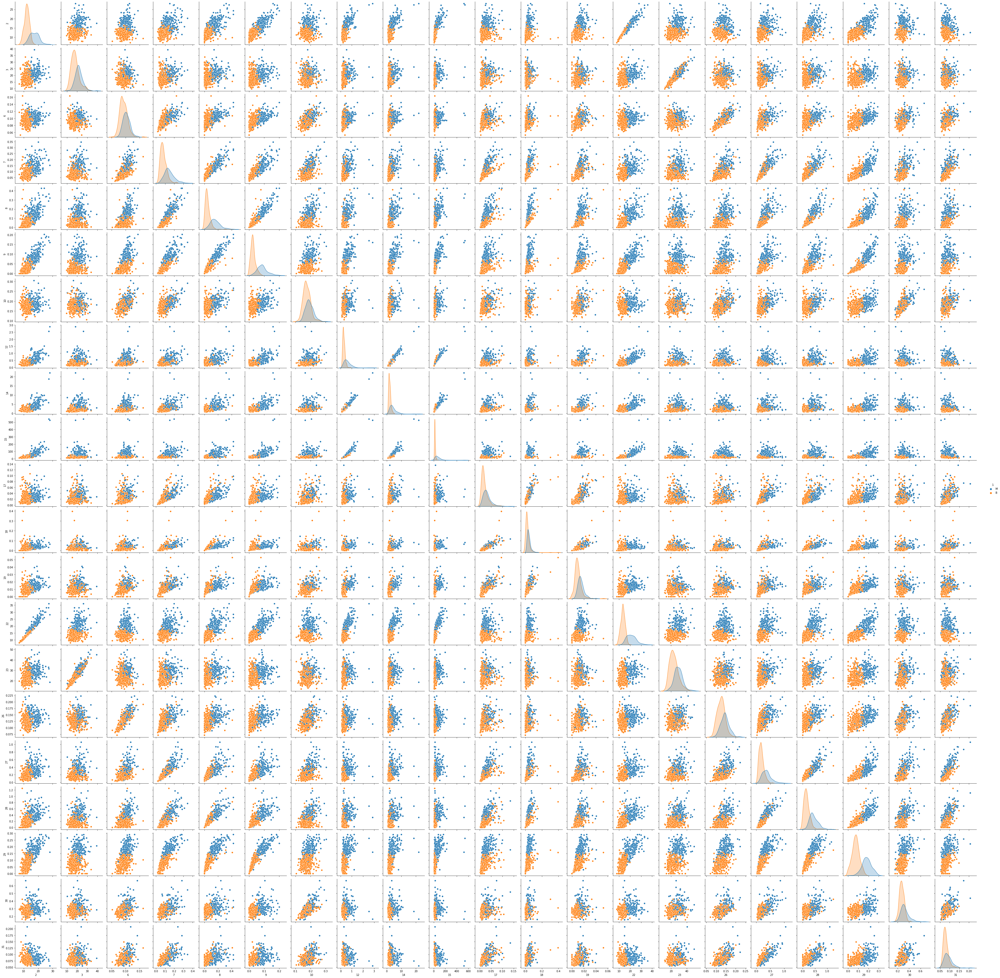

In [ ]:
#From this visualization, what features are you going to use for your logistic regression?


#의미없어 보이는 컬럼 삭제 
#0, 13, 16
#11, 20, 21
#4, 5, 24, 25

data_cols3 = copy.deepcopy(data_cols)
del_list = [0, 13, 16, 11, 20, 21, 4, 5, 24, 25]

for i in del_list:
  idx = data_cols3.index(i)
  del data_cols3[idx]

data_cols3.append(label)
print(data_cols3)

#pair plot

# Drop the columns of dataframe
df4pair2 = df.iloc[: , data_cols3] 
#df4pair2.describe()

sns.pairplot(df4pair2, hue=label)

##2-2. B, B 그룹별 분포 확인

In [ ]:
# 독립변수 데이터컬럼 리스트 초기화
data_cols = []

# 독립변수 데이터컬럼 길이 초기화
len_of_data_cols = 0

for col in df.columns:
    if( col != 1):
      data_cols.append(col)
      len_of_data_cols += 1
print('data_cols : ',data_cols)
print(len_of_data_cols)

data_cols :  [0, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31]
31


In [17]:
import copy

data_cols4 = copy.deepcopy(data_cols)
#del_list = [0, 13, 16]
#del_list = [0, 13, 16, 11, 20, 21, 4, 5, 24, 25, 14, 15]
#del_list = [14, 15]
#box-plot에서 outlier 많이 있는 컬럼, m, b 구간이 어느정도 겹치는 컬럼들 전부 제거
del_list = [0, 3, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 23, 26, 27, 28, 30, 31]

for i in del_list:
  idx = data_cols4.index(i)
  del data_cols4[idx]


if label  not in data_cols4:
  data_cols4.append(label)

print(data_cols4)

df2 = df.iloc[: , data_cols4] 
print(labels) #['M' 'B']
print(df2.columns)

#BM 컬럼을 label 컬럼으로, 각 그룹 문자열에서 0, 1 숫자로
df2[label] = pd.Categorical(df2[label])
df2['label'] = df2[label].cat.codes
#print(df2.columns)
#print(df2.head())


print(labels)
print(df2[label].cat) #Categories (2, object): ['B', 'M'] = [0, 1]
print(df2.columns)

# #필요없는 컬럼들 삭제후, 모델링에 사용할 독립변수 X만 컬럼들과 종속변수 y (label)컬럼만 존재하는 데이터 프레임 생성
df4=df2.drop(columns=[1])
#df4.head()
df4.tail()




[2, 4, 5, 6, 22, 24, 25, 29, 1]
['M' 'B']
Int64Index([2, 4, 5, 6, 22, 24, 25, 29, 1], dtype='int64')
['M' 'B']
Index([2, 4, 5, 6, 22, 24, 25, 29, 1, 'label'], dtype='object')


,2,4,5,6,22,24,25,29,label
564,21.56000,142.00000,1479.00000,0.11100,25.45000,166.10000,2027.00000,0.22160,1
565,20.13000,131.20000,1261.00000,0.09780,23.69000,155.00000,1731.00000,0.16280,1
566,16.60000,108.30000,858.10000,0.08455,18.98000,126.70000,1124.00000,0.14180,1
567,20.60000,140.10000,1265.00000,0.11780,25.74000,184.60000,1821.00000,0.26500,1
568,7.76000,47.92000,181.00000,0.05263,9.45600,59.16000,268.60000,0.00000,0


In [18]:
len_of_data_cols = 0
data_cols.clear()
for col in df4.columns:
    if(col != 'label'):
      data_cols.append(col)
      len_of_data_cols += 1
print('data_cols : ',data_cols)
print(len_of_data_cols)

#전체 데이터에서 그룹별 데이터 분리하기 
b_df4 = df4[df4['label']==0]
m_df4 = df4[df4['label']==1]

#BM별 데이터 앞부분 보기, 통계 분석
display(b_df4.head())
display(b_df4.describe().T)
display('--'*40)

display(m_df4.head())
display(m_df4.describe().T)
display('--'*40)



data_cols :  [2, 4, 5, 6, 22, 24, 25, 29]
8


,2,4,5,6,22,24,25,29,label
19,13.54000,87.46000,566.30000,0.09779,15.11000,99.70000,711.20000,0.12880,0
20,13.08000,85.63000,520.00000,0.10750,14.50000,96.09000,630.50000,0.07283,0
21,9.50400,60.34000,273.90000,0.10240,10.23000,65.13000,314.90000,0.06227,0
37,13.03000,82.61000,523.80000,0.08983,13.30000,84.46000,545.90000,0.05013,0
46,8.19600,51.71000,201.90000,0.08600,8.96400,57.26000,242.20000,0.02564,0


,count,mean,std,min,25%,50%,75%,max
2,357.00000,12.14652,1.78051,6.98100,11.08000,12.20000,13.37000,17.85000
4,357.00000,78.07541,11.80744,43.79000,70.87000,78.18000,86.10000,114.60000
5,357.00000,462.79020,134.28712,143.50000,378.20000,458.40000,551.10000,992.10000
6,357.00000,0.09248,0.01345,0.05263,0.08306,0.09076,0.10070,0.16340
22,357.00000,13.37980,1.98137,7.93000,12.08000,13.35000,14.80000,19.82000
24,357.00000,87.00594,13.52709,50.41000,78.27000,86.92000,96.59000,127.10000
25,357.00000,558.89944,163.60142,185.20000,447.10000,547.40000,670.00000,1210.00000
29,357.00000,0.07444,0.03580,0.00000,0.05104,0.07431,0.09749,0.17500
label,357.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000


'--------------------------------------------------------------------------------'

,2,4,5,6,22,24,25,29,label
0,17.99000,122.80000,1001.00000,0.11840,25.38000,184.60000,2019.00000,0.26540,1
1,20.57000,132.90000,1326.00000,0.08474,24.99000,158.80000,1956.00000,0.18600,1
2,19.69000,130.00000,1203.00000,0.10960,23.57000,152.50000,1709.00000,0.24300,1
3,11.42000,77.58000,386.10000,0.14250,14.91000,98.87000,567.70000,0.25750,1
4,20.29000,135.10000,1297.00000,0.10030,22.54000,152.20000,1575.00000,0.16250,1


,count,mean,std,min,25%,50%,75%,max
2,212.00000,17.46283,3.20397,10.95000,15.07500,17.32500,19.59000,28.11000
4,212.00000,115.36538,21.85465,71.90000,98.74500,114.20000,129.92500,188.50000
5,212.00000,978.37642,367.93798,361.60000,705.30000,932.00000,1203.75000,2501.00000
6,212.00000,0.10290,0.01261,0.07371,0.09401,0.10220,0.11092,0.14470
22,212.00000,21.13481,4.28357,12.84000,17.73000,20.59000,23.80750,36.04000
24,212.00000,141.37033,29.45706,85.10000,119.32500,138.00000,159.80000,251.20000
25,212.00000,1422.28632,597.96774,508.10000,970.30000,1303.00000,1712.75000,4254.00000
29,212.00000,0.18224,0.04631,0.02899,0.15275,0.18200,0.21068,0.29100
label,212.00000,1.00000,0.00000,1.00000,1.00000,1.00000,1.00000,1.00000


'--------------------------------------------------------------------------------'

# **3. 모델링 및 평가** <br>

### 3-1. 훈련, 테스트 데이터 분리

In [19]:
#모델링 라이브러리 임포트 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer

In [20]:
df5 = df4.copy(deep=True)

#https://thebook.io/080223/ch04/01/03/
#NaN value 핸들링
#컬럼 별 누락된 값은 해당 컬럼의 평균값으로 대체 
imr = SimpleImputer(missing_values=np.nan, strategy='mean')
imr = imr.fit(df5.values)


# 필드 정보를 뺀 데이터의 값들만 추출
#raw_data = df5.values
raw_data = imr.transform(df5.values)

# 레이블 Y값 분리 ##Categories (4, object): ['B', 'M] => [0 , 1]
labels = raw_data[:, -1]

# 데이터 X값 분리(data_1 ~ data_10)
data_xs = raw_data[:, 0:19]

# train, test 8:2 분리 
x_train, x_test, y_train, y_test = train_test_split(data_xs, labels, test_size=0.2, random_state=22, stratify = labels)

print('x_train data shape:',x_train.shape)
print('x_test data shape:',x_test.shape)

print('y_train label shape:',y_train.shape)
print('y_test label shape:',y_test.shape)

x_train data shape: (455, 9)
x_test data shape: (114, 9)
y_train label shape: (455,)
y_test label shape: (114,)


In [21]:
x_train

array([[1.624e+01, 1.088e+02, 8.051e+02, ..., 1.031e+03, 1.732e-01,
        1.000e+00],
       [1.487e+01, 9.864e+01, 6.825e+02, ..., 1.095e+03, 2.027e-01,
        1.000e+00],
       [1.305e+01, 8.509e+01, 5.120e+02, ..., 5.912e+02, 1.258e-01,
        0.000e+00],
       ...,
       [1.534e+01, 1.025e+02, 7.044e+02, ..., 9.809e+02, 2.393e-01,
        1.000e+00],
       [2.044e+01, 1.338e+02, 1.293e+03, ..., 1.780e+03, 1.765e-01,
        1.000e+00],
       [2.057e+01, 1.329e+02, 1.326e+03, ..., 1.956e+03, 1.860e-01,
        1.000e+00]])

* 데이터 정규화

>모델의 학습성능을 높이기 위하여 일정한 범위 [0,1] 로 정규화.





In [22]:
# MinMax 스케일링
scaler = MinMaxScaler()
x_train2 = scaler.fit_transform(x_train)
x_test2 = scaler.transform(x_test)


In [23]:
display(x_train2)
display('--------------'*10)
display(x_test2)

array([[0.43821288, 0.44924331, 0.28063627, ..., 0.20787456, 0.595189  ,
        1.        ],
       [0.37337309, 0.37903393, 0.22863203, ..., 0.22360401, 0.69656357,
        1.        ],
       [0.28723555, 0.28539838, 0.15630965, ..., 0.09978372, 0.43230241,
        0.        ],
       ...,
       [0.3956174 , 0.40570797, 0.23792153, ..., 0.19556134, 0.82233677,
        1.        ],
       [0.63699181, 0.62200263, 0.48759279, ..., 0.39195832, 0.60652921,
        1.        ],
       [0.64314449, 0.61578329, 0.50159067, ..., 0.43521431, 0.63917526,
        1.        ]])

'--------------------------------------------------------------------------------------------------------------------------------------------'

array([[0.21056368, 0.20641283, 0.10795334, ..., 0.07810657, 0.22      ,
        0.        ],
       [0.47654882, 0.48103103, 0.31876988, ..., 0.24670665, 0.87388316,
        1.        ],
       [0.34402953, 0.3636929 , 0.21302227, ..., 0.19030181, 0.61340206,
        1.        ],
       ...,
       [0.16560178, 0.16377583, 0.08063627, ..., 0.0627212 , 0.31993127,
        0.        ],
       [0.52387714, 0.52802156, 0.36585366, ..., 0.35017696, 0.72233677,
        1.        ],
       [0.27824317, 0.27226868, 0.15389183, ..., 0.1073781 , 0.27237113,
        0.        ]])

##3-2.모델 학습 및 평가

In [24]:
#모델 임포트 
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

###3-2.1 로지스틱 회귀모델


In [25]:
#로지스틱 회귀모델 훈련 
lr = LogisticRegression(random_state=1234)
lr.fit(x_train2, y_train)

LogisticRegression(random_state=1234)

In [26]:
y_pred_train = lr.predict(x_train2)

In [27]:
lr_train_report =  classification_report(y_train, y_pred_train)
print(lr_train_report)

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       285
         1.0       1.00      1.00      1.00       170

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455



###3-2.2 SVM

In [28]:
svc = SVC(random_state=1234)
svc.fit(x_train2, y_train)

SVC(random_state=1234)

In [29]:
y_pred_train = svc.predict(x_train2)

In [30]:
sv_train_report =  classification_report(y_train, y_pred_train)

print(sv_train_report)

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       285
         1.0       1.00      1.00      1.00       170

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455



###3-2.3 랜덤포레스트

In [31]:
rfc = RandomForestClassifier(random_state=1234)
rfc.fit(x_train2, y_train)

RandomForestClassifier(random_state=1234)

In [32]:
#예측 
y_pred_train = rfc.predict(x_train2)

In [33]:
rf_train_report =  classification_report(y_train, y_pred_train)

print(rf_train_report)

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       285
         1.0       1.00      1.00      1.00       170

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455



#4.모델 평가

##4.1 모델 예측

In [34]:
y_pred_test = lr.predict(x_test2)
#print(y_pred_test)

lr_test_report = classification_report(y_test, y_pred_test)
print(lr_test_report)


              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114



In [35]:
y_pred_test = svc.predict(x_test2)
sv_test_report = classification_report(y_test, y_pred_test)
print('**'*50)
print(sv_test_report)


****************************************************************************************************
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114



In [36]:
y_pred_test = rfc.predict(x_test2)
rf_test_report = classification_report(y_test, y_pred_test)
print('**'*50)
print(rf_test_report)


****************************************************************************************************
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114



##4.2 모델 성능 비교

In [37]:
print('############## 모델 성능 비교 ##############') 
print('############## 1. 로지스틱 회귀 ##############')
print(lr_test_report)

print('############## 2. SVM ##############')
print(sv_test_report)

print('############## 3. RandomForest ##############')
print(rf_test_report)


############## 모델 성능 비교 ##############
############## 1. 로지스틱 회귀 ##############
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114

############## 2. SVM ##############
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114

############## 3. RandomForest ##############
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy       

##4.3 Random Forest 모델 하이퍼파라미터 튜닝

In [38]:
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators' : [400,500], 
    'max_depth' : [6, 8, 10, 12]
}

rf_clf = RandomForestClassifier(random_state=1234, n_jobs=-1)
grid_cv = GridSearchCV(rf_clf, param_grid=params, cv=3, n_jobs=-1, scoring='accuracy')
grid_cv.fit(x_train, y_train)


print('최적 하이퍼 파라미터: ', grid_cv.best_params_)
print('최고 예측 정확도: {:.4f}'.format(grid_cv.best_score_))

최적 하이퍼 파라미터:  {'max_depth': 6, 'n_estimators': 400}
최고 예측 정확도: 1.0000


In [39]:
# ▶ Best score 파라미터로 다시 재학습
rfc = RandomForestClassifier(n_estimators=400, max_depth=6, random_state = 1234)
rfc.fit(x_train2, y_train)

# ▶ 예측
y_pred_train = rfc.predict(x_train2)
y_pred_test = rfc.predict(x_test2)


rf_train_report =  classification_report(y_train, y_pred_train)
rf_test_report = classification_report(y_test, y_pred_test)


In [40]:
rf_train_report =  classification_report(y_train, y_pred_train)
rf_test_report = classification_report(y_test, y_pred_test)

print(rf_train_report)
print('**'*50)
print(rf_test_report)

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       285
         1.0       1.00      1.00      1.00       170

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455

****************************************************************************************************
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114



##4.4 모델 성능 재비교

In [41]:
print('############## 모델 성능 비교 ##############') 
print('############## 1. 로지스틱 회귀 ##############')
print(lr_test_report)

print('############## 2. SVM ##############')
print(sv_test_report)

print('############## 3. RandomForest ##############')
print(rf_test_report)


############## 모델 성능 비교 ##############
############## 1. 로지스틱 회귀 ##############
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114

############## 2. SVM ##############
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy                           1.00       114
   macro avg       1.00      1.00      1.00       114
weighted avg       1.00      1.00      1.00       114

############## 3. RandomForest ##############
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00        72
         1.0       1.00      1.00      1.00        42

    accuracy       